In [ ]:
# if not installed, install in local env
# !pip install hrvanalysis && \
#     pip install plotly && \
#         pip install pyarrow && \
#             pip install fastparquet && \
#                 pip install seaborn && \
#                   pip install dask

In [1]:
# general 
import pandas as pd 
import numpy as np 
from datetime import datetime, timedelta
import pickle
import pyarrow as pa
import pyarrow.parquet as pq
import time

# plotting
import seaborn as sns 
import plotly.express as px
import matplotlib.pyplot as plt
from plotly.subplots import make_subplots
import plotly.graph_objects as go

plt.style.use('seaborn')
plt.rcParams["figure.figsize"] = (16, 8)
pd.options.plotting.backend = "plotly"

# HRV analysis
from hrvanalysis import get_time_domain_features, get_frequency_domain_features

In [2]:
cgmfile = "CGM_combined_phase3.csv"
hrvfile = "HRV_combined_phase3.csv"

If you're running this notebook for the first time, create pickle files to save time on subsequent loads. Run below cell!

In [6]:
# hrv_df = pd.read_csv(
#     hrvfile,
#     parse_dates={'datetime' : ['time', "date"]},
#     index_col='datetime',
#     )
 
# # create pkl files in /Pickle Files
# with open('Pickle Files/hrv_df_pkl', 'wb') as files:
#     pickle.dump(hrv_df, files)

In [4]:
# subsequent times *.pkl file must be present in current dir/
with open('Pickle Files/hrv_df_pkl', 'rb') as f:
    hrv_df = pickle.load(f)
    
hrv_df.drop(['seconds'], axis=1, inplace=True)

In [5]:
# repeat for cgm data
cgm_df = pd.read_csv(
    cgmfile,
    parse_dates=[2],
    dayfirst=True
)
    
# set datetime as index for CGM
cgm_df.set_index("datetime", inplace=True)

# drop irrelevant columns
cgm_df.drop(['device','serial number'], axis=1, inplace=True)

In [6]:
cgm_df.shape

(754, 1)

In [7]:
# HRV and CGM histograms
fig = make_subplots(
    rows=2, cols=2,
    subplot_titles=("HRV", "Glucose"))

fig.add_trace(go.Histogram(x=hrv_df['rr'], name="HRV Histogram"),
              row=1, col=1)

fig.add_trace(go.Histogram(x=cgm_df['glucose'], name="CGM Histogram"),
              row=1, col=2)

fig.add_trace(go.Scatter(y=hrv_df['rr'], x=hrv_df.index, name="HRV Lineplot"),
              row=2, col=1)

fig.add_trace(go.Scatter(y=cgm_df['glucose'], x=cgm_df.index, name="CGM Lineplot"),
              row=2, col=2)

fig.update_layout(height=800, width=1000,
                  title_text="HRV and Glucose")

fig.show()

In [8]:
print(hrv_df.head())
print(cgm_df.head())

                        rr
datetime                  
2022-03-27 07:14:56  0.815
2022-03-27 07:14:57  0.815
2022-03-27 07:14:58  0.813
2022-03-27 07:14:58  0.845
2022-03-27 07:14:59  0.861
                     glucose
datetime                    
2022-03-27 02:02:00      5.4
2022-03-27 02:17:00      4.9
2022-03-27 02:32:00      4.8
2022-03-27 02:47:00      4.9
2022-03-27 03:02:00      4.9


# HRV Data Processing

In [9]:
# convert HRV dataframe values to milliseconds
hrv_df = hrv_df.mul(1000, axis=1)

Text(0, 0.5, 'datetime')

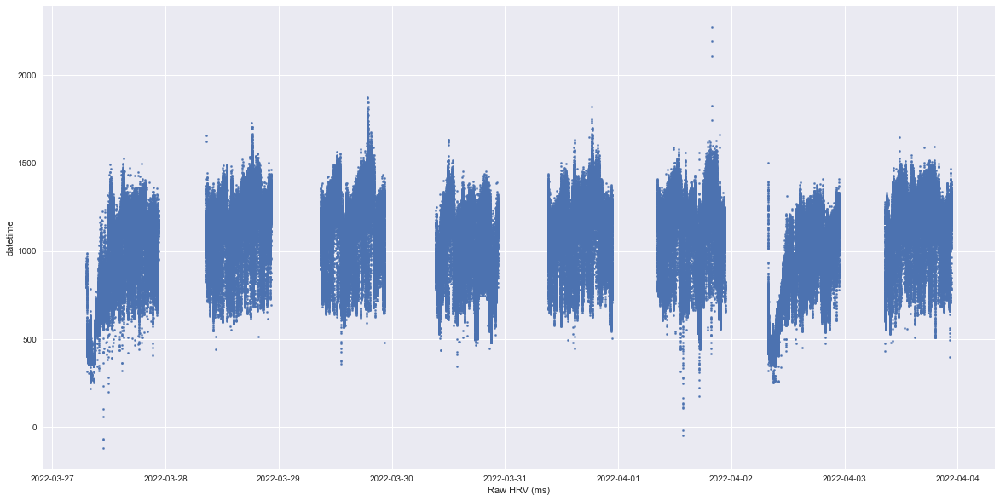

In [10]:
fig, ax = plt.subplots(figsize=(20, 10))
ax.scatter(x=hrv_df.index, y=hrv_df, s=5)
plt.xlabel('Raw HRV (ms)')
plt.ylabel('datetime')

In [11]:
# group by dates
date_groups = [group for name, group in hrv_df.groupby(pd.Grouper(freq="D"))]

In [12]:
# group all 'rr' values into 5 minute blocks of lists so that we can extract features from
def rolling_window(data_in_series, timescale='5T'):
    l = list(data_in_series.rolling(timescale))
    return pd.Series(l, index=data_in_series.index)

In [13]:
# create a list of 5 minute blocks for each day
hrv_blocks = [rolling_window(item['rr']) for item in date_groups]

In [93]:
# # for testing (uncomment cell to test on subsample of blocks)
# trunc_hrv_blocks = [hrv_blocks[1][500:1500],
#                     hrv_blocks[2][500:1500],
#                     hrv_blocks[3][500:1500],
#                     hrv_blocks[4][500:1500],
#                     hrv_blocks[5][500:1500],
#                     hrv_blocks[6][500:1500]]

To save time on processing, dask, a parallel computing library was leveraged. All operations below will involve the use of dask
- https://dask.org/


In [14]:
from dask.distributed import Client
client = Client(
    threads_per_worker=2,
    n_workers=6,
    processes=True
    )
client

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 4
Total threads: 8,Total memory: 31.95 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:56517,Workers: 4
Dashboard: http://127.0.0.1:8787/status,Total threads: 8
Started: Just now,Total memory: 31.95 GiB
Comm: tcp://127.0.0.1:56556,Total threads: 2
Dashboard: http://127.0.0.1:56557/status,Memory: 7.99 GiB
Nanny: tcp://127.0.0.1:56521,


In [15]:
def time_check(data_as_df):
    """Checks if all 5 minute blocks in a Pandas Dataframe is at leas 5 mins (10% error margin),
    drops blocks otherwise

    Args:
        data_as_df (Pandas Dataframe): Pandas Dataframe to execute operations on

    Returns:
        List: A list of all blocks which fulfill 5 minute criteria (10% error margin)
    """
    l = []
    for five_min_block in data_as_df:
        a_delta = timedelta(hours=five_min_block.index.time[0].hour,
                        minutes=five_min_block.index.time[0].minute,
                        seconds=five_min_block.index.time[0].second)

        b_delta = timedelta(hours=five_min_block.index.time[-1].hour,
                            minutes=five_min_block.index.time[-1].minute,
                            seconds=five_min_block.index.time[-1].second)

        timediff = b_delta - a_delta

        if timediff >= timedelta(minutes=4, seconds=45): # 10% error margin
            l.append(pd.Series(five_min_block, index=five_min_block.index))
    return l

In [18]:
def run_dask_parallel(data, job, params=None):
    """Using the dask futures API to parallelize our jobs

    Args:
        data (List): A list where each element is a daily dataframe, filled with blocks of 5 minutes
        job (Function): A function to execute on each element of data
        params (String, optional): Optional params that job will require to execute. Defaults to None.

    Returns:
        List: List of data with operations executed on
    """
    futures = []
    scattered_data = client.scatter(data)
    
    if not params:
        for i in scattered_data:
            f = client.submit(job, i)
            futures.append(f)
        return client.gather(futures) # run entire job
    else:
        for i in scattered_data:
            f = client.submit(job, i, params)
            futures.append(f)
        return client.gather(futures) # run entire job

In [19]:
%%time
corrected_hrv_blocks = run_dask_parallel(hrv_blocks, time_check)

CPU times: total: 3min 23s
Wall time: 6min 36s


In [24]:
# viz on how the HRV blocks look like
corrected_hrv_blocks[0][:2]

[datetime
 2022-03-27 07:14:56    815.0
 2022-03-27 07:14:57    815.0
 2022-03-27 07:14:58    813.0
 2022-03-27 07:14:58    845.0
 2022-03-27 07:14:59    861.0
                        ...  
 2022-03-27 07:19:39    497.0
 2022-03-27 07:19:39    500.0
 2022-03-27 07:19:40    483.0
 2022-03-27 07:19:40    494.0
 2022-03-27 07:19:41    496.0
 Name: rr, Length: 492, dtype: float64,
 datetime
 2022-03-27 07:14:56    815.0
 2022-03-27 07:14:57    815.0
 2022-03-27 07:14:58    813.0
 2022-03-27 07:14:58    845.0
 2022-03-27 07:14:59    861.0
                        ...  
 2022-03-27 07:19:39    500.0
 2022-03-27 07:19:40    483.0
 2022-03-27 07:19:40    494.0
 2022-03-27 07:19:41    496.0
 2022-03-27 07:19:41    480.0
 Name: rr, Length: 493, dtype: float64]

In [98]:
# extract HRV time domain/freq domain metrics
def generate_features(data, operations):
    """Generate HRV features from data provided

    Args:
        data (_type_): _description_
        operations (_type_): _description_

    Returns:
        _type_: _description_
    """
    f = []
    idx = []
    
    for _ in data:        
        f.append(operations(_.values))
        idx.append(_.index.max())
    
    return pd.DataFrame(f, index=idx)

Using the aura healthcare hrv analysis package
>https://github.com/Aura-healthcare/hrv-analysis/blob/master/hrvanalysis/extract_features.py

In [ ]:
%%time
time_feat_list = run_dask_parallel(corrected_hrv_blocks, generate_features, params=get_time_domain_features)

CPU times: total: 3min 23s
Wall time: 9min 7s


In [123]:
# after generating time domain features, shutdown the client to free RAM for freq domain features
client.shutdown()
time.sleep(10)

2022-04-06 23:45:58,635 - distributed.nanny - WARNING - Worker process still alive after 3.999998474121094 seconds, killing


In [124]:
# start new client
client = Client(
    threads_per_worker=2,
    n_workers=6,
    processes=True
    )
client

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 6
Total threads: 12,Total memory: 31.95 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:49939,Workers: 6
Dashboard: http://127.0.0.1:8787/status,Total threads: 12
Started: Just now,Total memory: 31.95 GiB
Comm: tcp://127.0.0.1:49966,Total threads: 2
Dashboard: http://127.0.0.1:49967/status,Memory: 5.33 GiB
Nanny: tcp://127.0.0.1:49944,


In [125]:
%%time
freq_feat_list = run_dask_parallel(corrected_hrv_blocks, generate_features,
                                   params=get_frequency_domain_features)

2022-04-06 23:46:28,832 - distributed.client - ERROR - Failed to reconnect to scheduler after 30.00 seconds, closing client


CPU times: total: 3min 20s
Wall time: 6min 12s


In [25]:
# skip to here if not the first time runnign this notebook
with open('Pickle Files/time_list_pkl', 'rb') as files:
    time_feat_list = pickle.load(files)
    
with open('Pickle Files/freq_list_pkl', 'rb') as files:
    freq_feat_list = pickle.load(files)

In [26]:
# join both time and frequency metrics together, create a combined HRV metric dataframe
def join_across(df1, df2, on=None, axis=1):
    # zip all together
    zipped = list(zip(df1, df2))
    l = []
    
    # reset index, join df
    for day in zipped:
        freq = day[0].reset_index().drop(on, axis=axis)
        time = day[1].reset_index()
        l.append(time.join(freq))
    
    return l

In [27]:
# join across
all_list_df = join_across(freq_feat_list, time_feat_list, on='index')

# rename and set index
for df in all_list_df:
    df.set_index('index', inplace=True)
    df.index.rename('datetime', inplace=True)

# view
all_list_df[0].head()

,mean_nni,sdnn,sdsd,nni_50,pnni_50,nni_20,pnni_20,rmssd,median_nni,range_nni,...,max_hr,min_hr,std_hr,lf,hf,lf_hf_ratio,lfnu,hfnu,total_power,vlf
datetime,,,,,,,,,,,,,,,,,,,,,
2022-03-27 07:19:41,579.373984,188.419134,26.306812,24,4.887984,67,13.645621,26.314834,467.5,579.0,...,145.631068,60.544904,30.813790,1038.015771,130.034214,7.982636,88.86741,11.13259,4837.659301,3669.609316
2022-03-27 07:19:41,579.172414,188.280756,26.289156,24,4.878049,67,13.617886,26.297972,469.0,579.0,...,145.631068,60.544904,30.786907,1038.015771,130.034214,7.982636,88.86741,11.13259,4837.659301,3669.609316
2022-03-27 07:19:42,578.995951,188.130592,26.268677,24,4.868154,67,13.590264,26.276846,469.5,579.0,...,145.631068,60.544904,30.758090,1038.015771,130.034214,7.982636,88.86741,11.13259,4837.659301,3669.609316
2022-03-27 07:19:42,578.826263,187.977996,26.242590,24,4.858300,67,13.562753,26.250583,470.0,579.0,...,145.631068,60.544904,30.728961,1038.015771,130.034214,7.982636,88.86741,11.13259,4837.659301,3669.609316
2022-03-27 07:19:43,578.633065,187.837310,26.221023,24,4.848485,67,13.535354,26.229600,470.0,579.0,...,145.631068,60.544904,30.701731,1038.015771,130.034214,7.982636,88.86741,11.13259,4837.659301,3669.609316


In [36]:
# generating plotable dataframe
plot_all = []
for i in all_list_df:
    i = i.resample('5T').median()
    i.interpolate(method='cubicspline', inplace=True)
    plot_all.append(i)

In [38]:
plot_all = pd.concat(plot_all)

px.scatter(data_frame=plot_all, x=plot_all.index,
           y=plot_all.columns, height=800, width=1000)

# CGM Data Processing

In [45]:
# upsample into 1 min intervals from 15min CGM values, take median
cgm_df = cgm_df.resample('1S').median()

In [46]:
# fn to check for NaNs and zeroes
def check_for_nans_zeroes(data):
    zero_count = [(data[col] == 0).sum() for col in data]
    NaN_count = [data[col].isnull().sum() for col in data]
    
    return pd.DataFrame(
    {'Number of Zeroes': zero_count, 'Number of Nans' : NaN_count},
    index=data.columns)
    
check_for_nans_zeroes(cgm_df)

,Number of Zeroes,Number of Nans
glucose,0,682828


In [47]:
# interpolate between readings
cgm_df.interpolate(method='cubicspline', inplace=True)

In [48]:
cgm_df.head()

,glucose
datetime,
2022-03-27 02:02:00,5.400000
2022-03-27 02:02:01,5.399165
2022-03-27 02:02:02,5.398330
2022-03-27 02:02:03,5.397496
2022-03-27 02:02:04,5.396662


In [49]:
# group individual days
daily_cgm_list = [group for name, group in cgm_df.groupby(pd.Grouper(freq="D"))]

In [50]:
# print first datetime and last datetime for all 8 days
def start_end_index(df):
    print(pd.DataFrame(
        {"Start Time": [day.index[0] for day in df],
        "End Time": [day.index[-1] for day in df]
        },
        index=[day for day in range(len(df))]
    ))

In [51]:
start_end_index(daily_cgm_list)

           Start Time            End Time
0 2022-03-27 02:02:00 2022-03-27 23:59:59
1 2022-03-28 00:00:00 2022-03-28 23:59:59
2 2022-03-29 00:00:00 2022-03-29 23:59:59
3 2022-03-30 00:00:00 2022-03-30 23:59:59
4 2022-03-31 00:00:00 2022-03-31 23:59:59
5 2022-04-01 00:00:00 2022-04-01 23:59:59
6 2022-04-02 00:00:00 2022-04-02 23:59:59
7 2022-04-03 00:00:00 2022-04-03 23:55:00


In [52]:
# concat all cgm values
full_day_cgm = pd.concat(daily_cgm_list)

In [53]:
# resample and get 5 minute values
full_day_min_cgm = full_day_cgm.resample('5T').median()
full_day_min_cgm.head()

,glucose
datetime,
2022-03-27 02:00:00,5.327921
2022-03-27 02:05:00,5.160626
2022-03-27 02:10:00,5.001092
2022-03-27 02:15:00,4.891237
2022-03-27 02:20:00,4.825255


In [54]:
px.line(data_frame=full_day_min_cgm, height=700, width=1000)

# Combined Processing

In [55]:
# load all pickle files (only if HRV process not done, see earlier cells)
with open('Pickle Files/all_list_pkl', 'rb') as f:
    daily_df_features = pickle.load(f)

In [56]:
# if running for the first time
daily_df_features = all_list_df

In [57]:
# day 0 of HRV recordings
daily_df_features[0].head()

,mean_nni,sdnn,sdsd,nni_50,pnni_50,nni_20,pnni_20,rmssd,median_nni,range_nni,...,max_hr,min_hr,std_hr,lf,hf,lf_hf_ratio,lfnu,hfnu,total_power,vlf
datetime,,,,,,,,,,,,,,,,,,,,,
2022-03-27 07:19:41,579.373984,188.419134,26.306812,24,4.887984,67,13.645621,26.314834,467.5,579.0,...,145.631068,60.544904,30.813790,1038.015771,130.034214,7.982636,88.86741,11.13259,4837.659301,3669.609316
2022-03-27 07:19:41,579.172414,188.280756,26.289156,24,4.878049,67,13.617886,26.297972,469.0,579.0,...,145.631068,60.544904,30.786907,1038.015771,130.034214,7.982636,88.86741,11.13259,4837.659301,3669.609316
2022-03-27 07:19:42,578.995951,188.130592,26.268677,24,4.868154,67,13.590264,26.276846,469.5,579.0,...,145.631068,60.544904,30.758090,1038.015771,130.034214,7.982636,88.86741,11.13259,4837.659301,3669.609316
2022-03-27 07:19:42,578.826263,187.977996,26.242590,24,4.858300,67,13.562753,26.250583,470.0,579.0,...,145.631068,60.544904,30.728961,1038.015771,130.034214,7.982636,88.86741,11.13259,4837.659301,3669.609316
2022-03-27 07:19:43,578.633065,187.837310,26.221023,24,4.848485,67,13.535354,26.229600,470.0,579.0,...,145.631068,60.544904,30.701731,1038.015771,130.034214,7.982636,88.86741,11.13259,4837.659301,3669.609316


In [58]:
# for each day of readings, join the cgm values to hrv features
def join_glucose_and_features(glucose_df_list, feature_df_list, on, how):
    l = []
    for day, values in enumerate(glucose_df_list):
        all = pd.merge(left=glucose_df_list[day],
                       right=feature_df_list[day],
                       on=on,
                       how=how)
        l.append(all)
    return l

CGM monitors blood glucose 24/7. HRV is only measured from the morning to evenings. Use an inner join to only obtain points where there are measurements.

In [59]:
# join list of individual days of CGM recordings with HRV recordings.
all_df = join_glucose_and_features(daily_cgm_list,
                                   daily_df_features,
                                   on="datetime",
                                   how="inner")

In [60]:
# print first datetime and last datetime for all 8 days
def start_end_index(df):
    df = pd.DataFrame(
        {"Start Time": [day.index[0] for day in df],
        "End Time": [day.index[-1] for day in df]
        },
        index=[f"Day {day}" for day in range(len(df))]
    )
    return df
    
start_end_index(all_df)

,Start Time,End Time
Day 0,2022-03-27 07:19:41,2022-03-27 22:28:01
Day 1,2022-03-28 08:44:18,2022-03-28 22:28:08
Day 2,2022-03-29 08:57:41,2022-03-29 22:30:35
Day 3,2022-03-30 09:23:08,2022-03-30 22:31:58
Day 4,2022-03-31 09:09:08,2022-03-31 22:44:15
Day 5,2022-04-01 08:21:10,2022-04-01 22:39:40
Day 6,2022-04-02 07:50:01,2022-04-02 22:56:30
Day 7,2022-04-03 08:36:59,2022-04-03 22:38:36


Start and end index for each day is different! Select the subset of all the days so that we have common points.

In [61]:
# truncate input days by latest start time and earliest 
# end time so that we can create multiple discrete sequences
trunc_all_df = [all_df[0].truncate(before=pd.Timestamp('2022-03-27 09:25:00'),
                                    after=pd.Timestamp('2022-03-27 22:25:00')),
                
                all_df[1].truncate(before=pd.Timestamp('2022-03-28 09:25:00'),
                                    after=pd.Timestamp('2022-03-28 22:25:00')),
                
                all_df[2].truncate(before=pd.Timestamp('2022-03-29 09:25:00'),
                                    after=pd.Timestamp('2022-03-29 22:25:00')),
                
                all_df[3].truncate(before=pd.Timestamp('2022-03-30 09:25:00'),
                                    after=pd.Timestamp('2022-03-30 22:25:00')),
                
                all_df[4].truncate(before=pd.Timestamp('2022-03-31 09:25:00'),
                                    after=pd.Timestamp('2022-03-31 22:25:00')),
                
                all_df[5].truncate(before=pd.Timestamp('2022-04-01 09:25:00'),
                                    after=pd.Timestamp('2022-04-01 22:25:00')),
                
                all_df[6].truncate(before=pd.Timestamp('2022-04-02 09:25:00'),
                                    after=pd.Timestamp('2022-04-02 22:25:00')),
                
                all_df[7].truncate(before=pd.Timestamp('2022-04-03 09:25:00'),
                                    after=pd.Timestamp('2022-04-03 22:25:00'))]

In [62]:
start_end_index(trunc_all_df)

,Start Time,End Time
Day 0,2022-03-27 09:25:00,2022-03-27 22:25:00
Day 1,2022-03-28 09:25:00,2022-03-28 22:24:59
Day 2,2022-03-29 09:25:00,2022-03-29 22:25:00
Day 3,2022-03-30 09:25:00,2022-03-30 22:25:00
Day 4,2022-03-31 09:25:00,2022-03-31 22:25:00
Day 5,2022-04-01 09:25:00,2022-04-01 22:25:00
Day 6,2022-04-02 09:25:00,2022-04-02 22:25:00
Day 7,2022-04-03 09:25:00,2022-04-03 22:25:00


A key analysis of different missing data imputation methods here:
>https://conferences.oreilly.com/strata/strata-ny-2019/cdn.oreillystatic.com/en/assets/1/event/300/Handling%20data%20gaps%20in%20time%20series%20using%20imputation%20Presentation.pdf

In [63]:
def resample_indiv_col(ls_of_df):
    l = []
    for i, v in enumerate(ls_of_df):
        d1 = ls_of_df[i].resample('5T').median()
        d1.interpolate(method='cubicspline', inplace=True)
        l.append(d1)
    return l

all_df_min = resample_indiv_col(trunc_all_df)

In [64]:
# flatten out entire list and truncate all dateframes
final_df = pd.concat(all_df_min)

In [65]:
final_df.tail()

,glucose,mean_nni,sdnn,sdsd,nni_50,pnni_50,nni_20,pnni_20,rmssd,median_nni,...,max_hr,min_hr,std_hr,lf,hf,lf_hf_ratio,lfnu,hfnu,total_power,vlf
datetime,,,,,,,,,,,,,,,,,,,,,
2022-04-03 22:05:00,5.226497,1002.918060,201.327229,46.618268,75.0,25.167785,162.0,54.362416,46.619226,1044.0,...,88.105727,45.351474,13.528614,1699.020730,336.585687,6.063292,85.842295,14.157705,8830.033765,6396.076172
2022-04-03 22:10:00,5.170552,1098.223443,140.382250,45.132699,63.0,23.161765,174.0,63.970588,45.132974,1131.0,...,89.285714,44.477391,8.827321,2086.112797,232.137793,9.164138,90.161487,9.838513,9273.234570,6807.460499
2022-04-03 22:15:00,5.141560,891.843929,170.381836,73.299538,80.0,23.188406,194.0,56.231884,73.305284,847.0,...,150.000000,47.355959,13.468948,2684.652082,829.441367,2.807618,73.736860,26.263140,7541.272755,4382.362342
2022-04-03 22:20:00,5.157644,959.347429,155.007731,77.321731,110.0,37.542662,201.0,67.687075,77.327986,936.0,...,87.082729,45.214770,10.404029,3383.888796,690.588813,4.348859,81.288658,18.711342,13145.636219,8589.932733
2022-04-03 22:25:00,5.200000,1014.986301,209.819821,50.380059,83.0,28.522337,191.0,65.635739,50.380886,951.0,...,84.507042,40.899796,12.131048,1823.540038,351.002607,5.195232,83.858555,16.141445,8589.591264,6415.048619


In [66]:
px.scatter(data_frame=final_df)

In [67]:
final_df.shape

(1255, 24)

In [68]:
# fn to check for NaNs and zeroes
def check_for_nans_zeroes(data):
    zero_count = [(data[col] == 0).sum() for col in data]
    NaN_count = [data[col].isnull().sum() for col in data]
    
    return pd.DataFrame(
    {'Number of Zeroes': zero_count, 'Number of Nans' : NaN_count},
    index=data.columns)
    
check_for_nans_zeroes(final_df) # some zeroes observed in nni and pnni metrics

,Number of Zeroes,Number of Nans
glucose,0,0
mean_nni,0,0
sdnn,0,0
sdsd,0,0
nni_50,9,0
pnni_50,9,0
nni_20,1,0
pnni_20,1,0
rmssd,0,0
median_nni,0,0


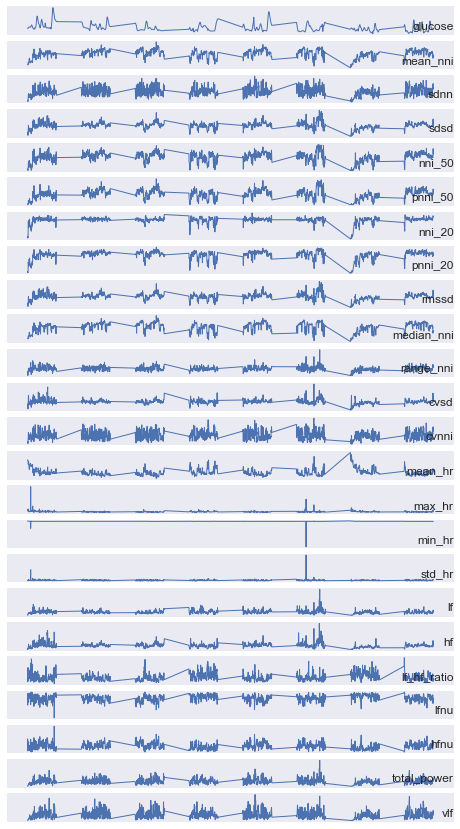

In [69]:
# histogram plot for each variable
def plot_hist(df):
    plt.figure(figsize=(8, 15))
    for i in range(len(df.columns)):
        plt.subplot(len(df.columns), 1, i+1)
        name = df.columns[i]
        plt.plot(df[name], linewidth=1)
        plt.title(name, y=0, loc='right')
        plt.yticks([])
        plt.xticks([])
    plt.show()

# visualize distribution
plot_hist(final_df)

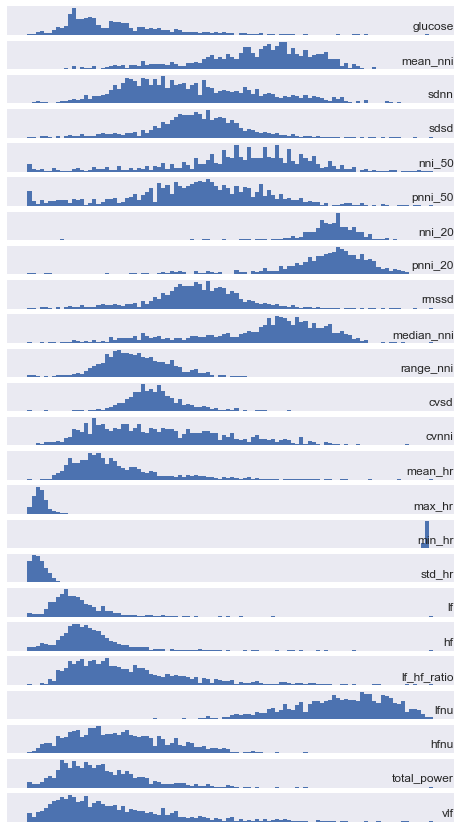

In [70]:
# histogram plot for each variable
def plot_hist(df):
    plt.figure(figsize=(8, 15))
    for i in range(len(df.columns)):
        plt.subplot(len(df.columns), 1, i+1)
        name = df.columns[i]
        plt.hist(df[name], bins=100)
        plt.title(name, y=0, loc='right')
        plt.yticks([])
        plt.xticks([])
    plt.show()

# visualize distribution
plot_hist(final_df)

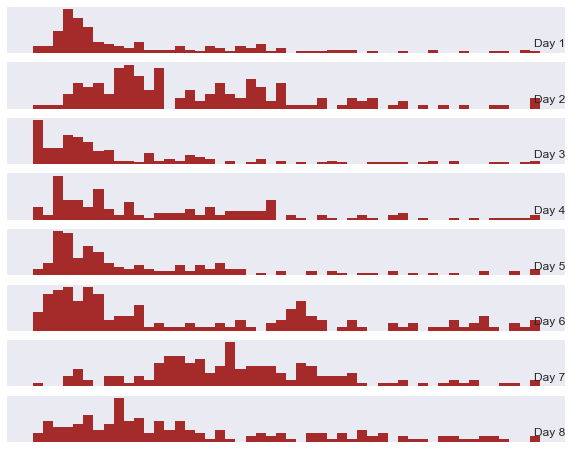

In [71]:
# plot glucose distribution per day
def plot_glucose_levels(df, freq='D'):
    date_groups = [group for name, group in df.groupby(pd.Grouper(freq=freq))]
    days = ["Day 1", "Day 2", "Day 3", "Day 4", "Day 5", "Day 6", "Day 7", "Day 8"]

    plt.figure(figsize=(10, 8))
    for i in range(len(days)):
        plt.subplot(len(days), 1, i+1)
        day = days[i]
        result = date_groups[i]
        plt.hist(result, bins=50, color='brown')
        plt.title(str(day), y=0, loc='right')
        plt.yticks([])
        plt.xticks([])            
    plt.show()

plot_glucose_levels(final_df['glucose'])

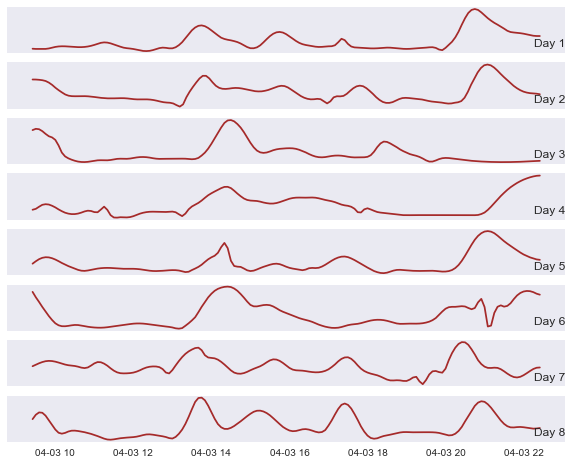

In [72]:
# plot changing glucose levels per day
def plot_glucose_levels(df, freq='D'):
    date_groups = [group for name, group in df.groupby(pd.Grouper(freq=freq))]
    days = ["Day 1", "Day 2", "Day 3", "Day 4", "Day 5", "Day 6", "Day 7", "Day 8"]

    plt.figure(figsize=(10, 8))
    for i in range(len(days)):
        plt.subplot(len(days), 1, i+1)
        day = days[i]
        result = date_groups[i]
        if i == len(days)-1:
            plt.grid(False)
            plt.plot(result, color="brown")
            plt.title(str(day), y=0, loc='right')
            plt.yticks([])
            break
        plt.plot(result, color="brown")
        plt.title(str(day), y=0, loc='right')
        plt.yticks([])
        plt.xticks([])
    plt.show()

plot_glucose_levels(final_df['glucose'])

#### Save relevant dataframes as parquet files

If running for the first time, save relevant dataframes as parquet files.

In [374]:
# # cgm dataframe (raw cgm dataframe, sampling of 1s)
# cgm_df.to_parquet('Parquet Files/cgm_df.parquet.gzip')

# # cgm dataframe (sampling of 5 mins)
# full_day_min_cgm.to_parquet('Parquet Files/full_day_min_cgm.parquet.gzip')

# # final truncated dataframe
# final_df.to_parquet('Parquet Files/final_df.parquet.gzip')

If running for the first time, save files as pickle files to save preprocessing time.

In [375]:
# # save everything else as pickle binaries
# with open('Pickle Files/freq_list_pkl', 'wb') as files:
#     pickle.dump(freq_feat_list, files)
    
# with open('Pickle Files/time_list_pkl', 'wb') as files:
#     pickle.dump(time_feat_list, files)
    
# with open('Pickle Files/all_list_pkl', 'wb') as files:
#     pickle.dump(all_list_df, files)